
#cod_cliente --> Código do cliente no conglomerado
#sexo --> Sexo
#estado_civil --> Solteiro/casado
#dependentes --> Quantidade de filhos
#educacao --> Qual a escolaridade
#empregado --> Se está trabalhando
#renda --> Valor da renda mensal
#renda_conjuge --> Valor da renda mensal do companheiro
#emprestimo --> Valor do empréstimo solicitado (em milhar)
#prestacao_mensal --> Valor da prestação mensal a ser paga
#historico_credito --> Se o cliente já atrasou ou esteve em situação de descumprimento das obrigações
#imovel --> Se o cliente possui imóvel
#aprovacao_emprestimo --> Se houve aprovação (sim ou não) do empréstimo solicitado.

In [5]:
## Pacotes
import pandas as pd     #Biblioteca de Funções de Manipulação de Dados
import numpy as np
!pip install dataprep
import seaborn as sns   #Biblioteca de Funções de Visualização Gráfica
import warnings
warnings.filterwarnings("ignore")



     |████████████████████████████████| 1.8 MB 5.1 MB/s 
     |████████████████████████████████| 848 kB 44.1 MB/s 
     |████████████████████████████████| 366 kB 57.2 MB/s 
     |████████████████████████████████| 63 kB 2.3 MB/s 
     |████████████████████████████████| 719 kB 54.4 MB/s 
     |████████████████████████████████| 1.5 MB 34.5 MB/s 
     |████████████████████████████████| 10.1 MB 41.3 MB/s 
     |████████████████████████████████| 50 kB 5.7 MB/s 
     |████████████████████████████████| 1.3 MB 54.5 MB/s 
     |████████████████████████████████| 142 kB 56.9 MB/s 
     |████████████████████████████████| 294 kB 59.4 MB/s 
     |████████████████████████████████| 118 kB 63.0 MB/s 
     |████████████████████████████████| 49 kB 4.7 MB/s 
     |████████████████████████████████| 743 kB 65.2 MB/s 
  Created wheel for metaphone: filename=Metaphone-0.6-py3-none-any.whl size=13919 sha256=a4c1ea99a4cb7165b8aa6c85c89a59af4de384129f036e54a31913a33e57a45c
  Stored in directory: /root/.cache/pip/

In [6]:
!apt-get install openjdk-8-jdk-headless -qq > /dev/null
!wget -q https://archive.apache.org/dist/spark/spark-2.4.4/spark-2.4.4-bin-hadoop2.7.tgz
!tar xf spark-2.4.4-bin-hadoop2.7.tgz
!pip install -q findspark

# configurar as variáveis de ambiente
import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-2.4.4-bin-hadoop2.7"

# tornar o pyspark "importável"
import findspark
findspark.init('spark-2.4.4-bin-hadoop2.7')

In [7]:
from pyspark.sql import SparkSession

sc = SparkSession.builder.master('local[*]').getOrCreate()

df = "/content/db_clientes.csv"

clientes = sc.read.format("csv").options(inferSchema=True, header=True, sep=',').load(df).toPandas()

NumExpr defaulting to 2 threads.


DataPrep Report
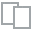
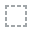
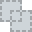
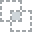
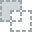
...
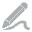
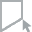
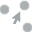
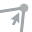
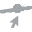

In [8]:
from dataprep.eda import create_report
create_report(clientes)

In [9]:
#Verifica as Dimensões do Arquivo
clientes.shape

(614, 13)

In [10]:
#Verificando os primeiros registros
clientes.head()

,cod_cliente,sexo,estado_civil,dependentes,educacao,empregado,renda,renda_conjuge,emprestimo,prestacao_mensal,historico_credito,imovel,aprovacao_emprestimo
0,LP001002,Male,No,0,Graduate,No,5849,0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0,141.0,360.0,1.0,Urban,Y


In [11]:
#Verificando as informações dos campos da tabela de dados
clientes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 614 entries, 0 to 613
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   cod_cliente           614 non-null    object 
 1   sexo                  601 non-null    object 
 2   estado_civil          611 non-null    object 
 3   dependentes           599 non-null    object 
 4   educacao              614 non-null    object 
 5   empregado             582 non-null    object 
 6   renda                 614 non-null    int32  
 7   renda_conjuge         614 non-null    object 
 8   emprestimo            592 non-null    float64
 9   prestacao_mensal      600 non-null    float64
 10  historico_credito     564 non-null    float64
 11  imovel                614 non-null    object 
 12  aprovacao_emprestimo  614 non-null    object 
dtypes: float64(3), int32(1), object(9)
memory usage: 60.1+ KB


In [12]:
#Verifica se há valores Nulos/ausentes
clientes.isnull().sum()

cod_cliente              0
sexo                    13
estado_civil             3
dependentes             15
educacao                 0
empregado               32
renda                    0
renda_conjuge            0
emprestimo              22
prestacao_mensal        14
historico_credito       50
imovel                   0
aprovacao_emprestimo     0
dtype: int64

In [13]:
#verifica se há valores duplicados
clientes.duplicated().sum()

0

### Conhecendo a Distribuição dos Dados de Cada Variável/Campo

In [14]:
#Estatísticas descritivas das variáveis numéricas
clientes.describe()

,renda,emprestimo,prestacao_mensal,historico_credito
count,614.000000,592.000000,600.00000,564.000000
mean,5403.459283,146.412162,342.00000,0.842199
std,6109.041673,85.587325,65.12041,0.364878
min,150.000000,9.000000,12.00000,0.000000
25%,2877.500000,100.000000,360.00000,1.000000
50%,3812.500000,128.000000,360.00000,1.000000
75%,5795.000000,168.000000,360.00000,1.000000
max,81000.000000,700.000000,480.00000,1.000000


In [15]:
# Tabela de Frequência da Variável "aprovacao_emprestimo" - Nossa Classe ou Label ou Target ou Y ou Variável a ser Predita (o que a gente quer descobrir)
clientes.aprovacao_emprestimo.value_counts()

Y    422
N    192
Name: aprovacao_emprestimo, dtype: int64

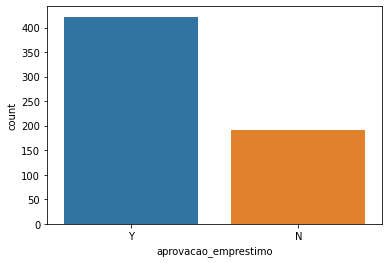

In [16]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['aprovacao_emprestimo'])

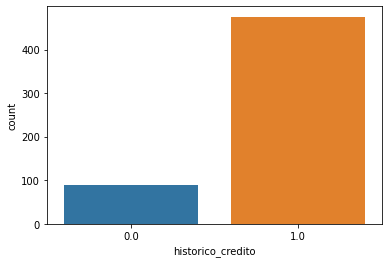

In [17]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['historico_credito'])

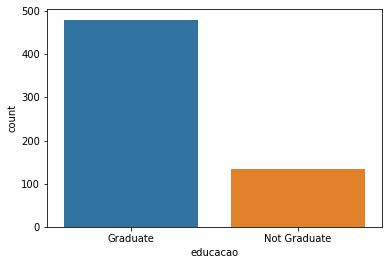

In [18]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['educacao'])

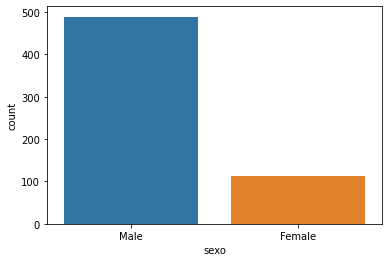

In [19]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['sexo'])

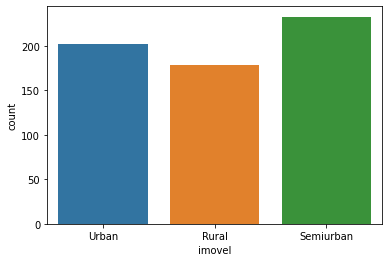

In [20]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['imovel'])

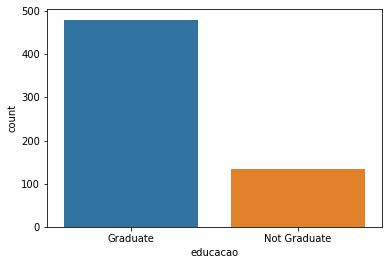

In [21]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['educacao'])

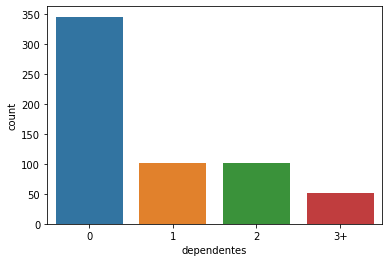

In [22]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['dependentes'])

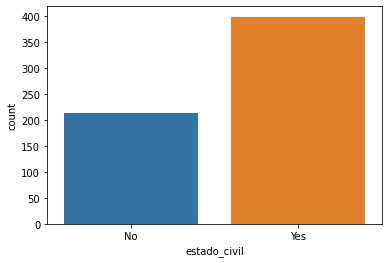

In [23]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['estado_civil'])

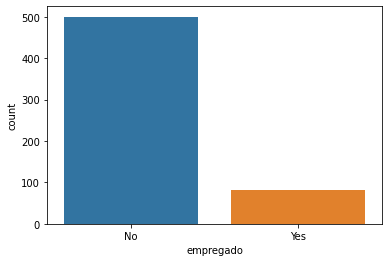

In [24]:
#Criando Gráfico de Barras para variáveis Categóricas
sns.countplot(clientes['empregado'])

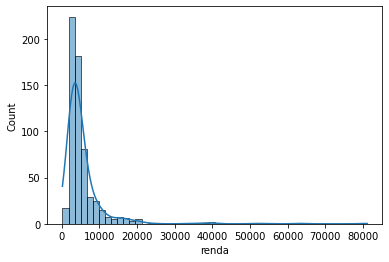

In [25]:
#Criando Gráfico de Distribuição para variáveis contínuas
sns.histplot(clientes['renda'], bins=50, kde=True)

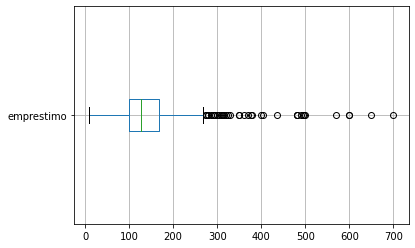

In [26]:
#Distribuição dos dados BOXPLOT
clientes.boxplot(column='emprestimo', vert=False )

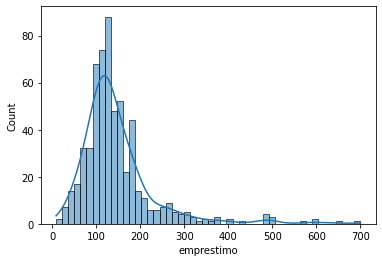

In [27]:
#Criando Gráfico de Distribuição para variáveis contínuas
sns.histplot(clientes['emprestimo'], bins=50, kde=True)

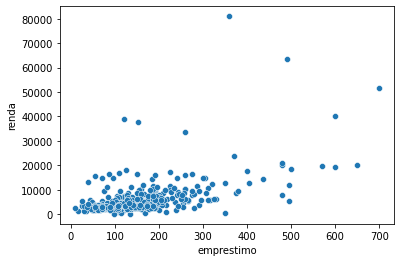

In [28]:
# Correlação entre as Variáveis
sns.scatterplot(data=clientes, x="emprestimo", y="renda", ) #hue='aprovacao_emprestimo')

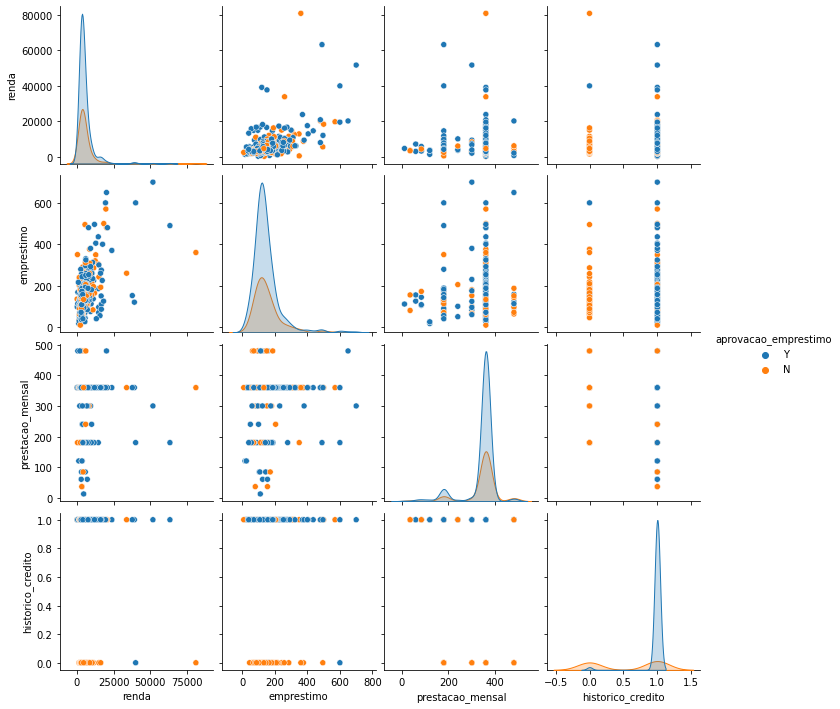

In [29]:
# Criação do Gráfico de dispersão (scatter) conhecido como pairplot
sns.pairplot(clientes, hue='aprovacao_emprestimo') # kind=reg é a reta de regressão

In [30]:
# Eliminando valores Nulos
clientes = clientes.dropna(subset=['sexo','estado_civil','renda','emprestimo','historico_credito'])
clientes.isnull().sum()

cod_cliente              0
sexo                     0
estado_civil             0
dependentes             11
educacao                 0
empregado               26
renda                    0
renda_conjuge            0
emprestimo               0
prestacao_mensal        14
historico_credito        0
imovel                   0
aprovacao_emprestimo     0
dtype: int64

In [31]:
# Buscando ferramentas para gerar vetores das Strings e criando dataframe para leitura no spark
from pyspark.ml.feature import VectorAssembler,OneHotEncoder, StringIndexer
from pyspark.ml import Pipeline
sparkdata=sc.createDataFrame(clientes)
sparkdata.show()

+-----------+------+------------+-----------+------------+---------+-----+-------------+----------+----------------+-----------------+---------+--------------------+
|cod_cliente|  sexo|estado_civil|dependentes|    educacao|empregado|renda|renda_conjuge|emprestimo|prestacao_mensal|historico_credito|   imovel|aprovacao_emprestimo|
+-----------+------+------------+-----------+------------+---------+-----+-------------+----------+----------------+-----------------+---------+--------------------+
|   LP001003|  Male|         Yes|          1|    Graduate|       No| 4583|         1508|     128.0|           360.0|              1.0|    Rural|                   N|
|   LP001005|  Male|         Yes|          0|    Graduate|      Yes| 3000|            0|      66.0|           360.0|              1.0|    Urban|                   Y|
|   LP001006|  Male|         Yes|          0|Not Graduate|       No| 2583|         2358|     120.0|           360.0|              1.0|    Urban|                   Y|
|   

In [32]:
stringIndexer_sexo=StringIndexer(inputCol="sexo", outputCol="sexo_encoded")  #label encoding
encoder_sexo = OneHotEncoder(dropLast=False, inputCol="sexo_encoded", outputCol="sexoVec") #one-hot encoding

stringIndexer_estado_civil=StringIndexer(inputCol="estado_civil", outputCol="estado_civil_encoded")  #label encoding
encoder_estado_civil = OneHotEncoder(dropLast=False, inputCol="estado_civil_encoded", outputCol="estado_civilVec") #one-hot encoding

stringIndexer_aprovacao_emprestimo=StringIndexer(inputCol="aprovacao_emprestimo", outputCol="aprovacao_emprestimo_encoded")  #label encoding
encoder_aprovacao_emprestimo = OneHotEncoder(dropLast=False, inputCol="aprovacao_emprestimo_encoded", outputCol="aprovacao_emprestimoVec") #one-hot encoding


colunas_entrada=['sexoVec','estado_civilVec','renda','emprestimo','historico_credito']
vetor_entrada = VectorAssembler(inputCols=colunas_entrada,outputCol='features')
sequencia_transformacoes=[stringIndexer_sexo,stringIndexer_estado_civil,stringIndexer_aprovacao_emprestimo,encoder_sexo,encoder_estado_civil,encoder_aprovacao_emprestimo,vetor_entrada]

In [33]:
# Aplicando o pipeline
  
!pip install -q lib5c
!lib5c -v
from pyspark.ml import Pipeline


     |████████████████████████████████| 16.2 MB 136 kB/s 
     |████████████████████████████████| 1.2 MB 60.8 MB/s 
lib5c version 0.6.1


In [34]:
pipeline = Pipeline(stages=sequencia_transformacoes)
pipelineModel = pipeline.fit(sparkdata)
model = pipelineModel.transform(sparkdata)

In [35]:
model.show()

+-----------+------+------------+-----------+------------+---------+-----+-------------+----------+----------------+-----------------+---------+--------------------+------------+--------------------+----------------------------+-------------+---------------+-----------------------+--------------------+
|cod_cliente|  sexo|estado_civil|dependentes|    educacao|empregado|renda|renda_conjuge|emprestimo|prestacao_mensal|historico_credito|   imovel|aprovacao_emprestimo|sexo_encoded|estado_civil_encoded|aprovacao_emprestimo_encoded|      sexoVec|estado_civilVec|aprovacao_emprestimoVec|            features|
+-----------+------+------------+-----------+------------+---------+-----+-------------+----------+----------------+-----------------+---------+--------------------+------------+--------------------+----------------------------+-------------+---------------+-----------------------+--------------------+
|   LP001003|  Male|         Yes|          1|    Graduate|       No| 4583|         1508|

In [36]:
#divide os dados para treino e testes
train_data, test_data = model.randomSplit([.8,.2],seed=5)

#define o modelo de regrssão logística
from pyspark.ml.classification import LogisticRegression

#instancia o objeto para a regressão logística
lr = LogisticRegression(labelCol="aprovacao_emprestimo_encoded",featuresCol="features", maxIter=100, regParam=0.3)

# treina o modelo
linearModel = lr.fit(train_data)

In [37]:
#avaliação da acuracia do modelo
previsao_regressao = linearModel.transform(test_data)
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
acc_evaluator = MulticlassClassificationEvaluator(labelCol="aprovacao_emprestimo_encoded", predictionCol="prediction", metricName="accuracy")
acuracia_regressao = acc_evaluator.evaluate(previsao_regressao)
print('Regressão Logística: {0:2.2f}%'.format(acuracia_regressao*100))

Regressão Logística: 82.73%


In [38]:
#__________________________________________________________________________

In [39]:
teste2 = clientes.copy()
teste2

,cod_cliente,sexo,estado_civil,dependentes,educacao,empregado,renda,renda_conjuge,emprestimo,prestacao_mensal,historico_credito,imovel,aprovacao_emprestimo
1,LP001003,Male,Yes,1,Graduate,No,4583,1508,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0,141.0,360.0,1.0,Urban,Y
5,LP001011,Male,Yes,2,Graduate,Yes,5417,4196,267.0,360.0,1.0,Urban,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,LP002978,Female,No,0,Graduate,No,2900,0,71.0,360.0,1.0,Rural,Y
610,LP002979,Male,Yes,3+,Graduate,No,4106,0,40.0,180.0,1.0,Rural,Y
611,LP002983,Male,Yes,1,Graduate,No,8072,240,253.0,360.0,1.0,Urban,Y
612,LP002984,Male,Yes,2,Graduate,No,7583,0,187.0,360.0,1.0,Urban,Y


In [40]:
teste2['sexo']= teste2['sexo'].map({'Male':0, 'Female':1})
teste2['estado_civil']= teste2['estado_civil'].map({'No':0, 'Yes':1})
teste2['aprovacao_emprestimo']= teste2['aprovacao_emprestimo'].map({'N':0, 'Y':1})

In [41]:
teste2

,cod_cliente,sexo,estado_civil,dependentes,educacao,empregado,renda,renda_conjuge,emprestimo,prestacao_mensal,historico_credito,imovel,aprovacao_emprestimo
1,LP001003,0,1,1,Graduate,No,4583,1508,128.0,360.0,1.0,Rural,0
2,LP001005,0,1,0,Graduate,Yes,3000,0,66.0,360.0,1.0,Urban,1
3,LP001006,0,1,0,Not Graduate,No,2583,2358,120.0,360.0,1.0,Urban,1
4,LP001008,0,0,0,Graduate,No,6000,0,141.0,360.0,1.0,Urban,1
5,LP001011,0,1,2,Graduate,Yes,5417,4196,267.0,360.0,1.0,Urban,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,LP002978,1,0,0,Graduate,No,2900,0,71.0,360.0,1.0,Rural,1
610,LP002979,0,1,3+,Graduate,No,4106,0,40.0,180.0,1.0,Rural,1
611,LP002983,0,1,1,Graduate,No,8072,240,253.0,360.0,1.0,Urban,1
612,LP002984,0,1,2,Graduate,No,7583,0,187.0,360.0,1.0,Urban,1


In [42]:
X = teste2[['sexo', 'estado_civil', 'renda', 'emprestimo', 'historico_credito']]
y = teste2.aprovacao_emprestimo
X.shape, y.shape

((529, 5), (529,))

In [43]:
from sklearn.model_selection import train_test_split

In [44]:
x_train, x_teste, y_train, y_teste = train_test_split(X,y, test_size = 0.2, random_state = 7)

In [45]:
from sklearn.ensemble import RandomForestClassifier

In [46]:
maquina = RandomForestClassifier(max_depth=4, random_state=7)
maquina.fit(x_train,y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=4, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=7, verbose=0,
                       warm_start=False)

In [47]:
from sklearn.metrics import accuracy_score 

In [48]:
pred_maquina = maquina.predict(x_train)
accuracy_score(y_train,pred_maquina)

0.8156028368794326

In [49]:
pred_maquina = maquina.predict(x_teste)
accuracy_score(y_teste,pred_maquina)

0.8773584905660378

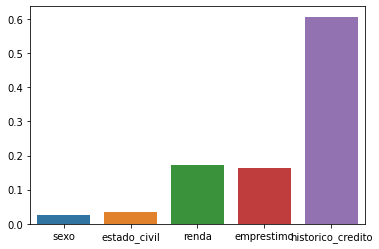

In [50]:
#importancia de cada variável na predição
sns.barplot(x=['sexo', 'estado_civil', 'renda', 'emprestimo', 'historico_credito'],y=(maquina.feature_importances_))

In [51]:
#salvando máquina
import pickle
pickle_out = open ("maquina_predict.pkl", mode = "wb")
pickle.dump(maquina, pickle_out)
pickle_out.close()

In [52]:
#pacote para conexao da maquina na WEB
!pip install pyngrok
from pyngrok import ngrok
#pacote para implementação da maquina na WEB
!pip install -q streamlit
!pip install -q streamlit_ace


     |████████████████████████████████| 746 kB 5.0 MB/s 
  Created wheel for pyngrok: filename=pyngrok-5.0.6-py3-none-any.whl size=19262 sha256=89556df72f73db0688455067d854a178ca2f6539095934a771c5f0bd86096b3a
  Stored in directory: /root/.cache/pip/wheels/d5/8c/c4/8d9cbca4fa19bf64887b4a91914194bb9033f1a7cbb344d5ab
Successfully built pyngrok
     |████████████████████████████████| 8.0 MB 4.2 MB/s 
     |████████████████████████████████| 75 kB 3.0 MB/s 
     |████████████████████████████████| 111 kB 39.4 MB/s 
     |████████████████████████████████| 4.2 MB 13.7 MB/s 
     |████████████████████████████████| 170 kB 56.1 MB/s 
     |████████████████████████████████| 63 kB 1.6 MB/s 
     |████████████████████████████████| 122 kB 59.3 MB/s 
     |████████████████████████████████| 786 kB 25.8 MB/s 
     |████████████████████████████████| 368 kB 26.3 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of t

In [53]:
#criar maquina no arquivo app.py
%%writefile app.py

#carregando maquina
import pickle
import streamlit as st
pickle_in open('maquina_predict.pkl', 'rb')
maquina_preditiva = pickle.load(pickle_in)

#mantendo a sessao em cache
@st.cache()

#criando função para fazer a predição com os dados importados
def prediction(sexo,estado_civil,renda,emprestimo,historico_credito):
  #pre processamento dos dados de entrada
  if sexo == "Masculino":
    sexo=0
  else:
    sexo=1
  
  if estado_civil == "Solteiro(a)":
    estado_civil=0
  else:
    estado_civil=1

  if historico_credito == "Débitos Pendentes":
    historico_credito=0
  else:
    historico_credito=1

emprestimo=emprestimo/1000

#executando a maquina para realizar a predição
prediction = maquina_preditiva.predict([sexo,estado_civil,renda,emprestimo,historico_credito])

if prediction == 0:
  pred = "Rejeitado"
else:
  pred = "Aprovado"

  #Criando webpage
def main()
      #Elementos da webpage
      html_temp = """
      <div style = "background-color:blue;padding:13px">
      <h1 style = "color:white;text-align:center;">SAE</h1>
      <h2 style = "color:white;text-align:center">Sistema de Aprovação de Empréstimos</h2>
      </div>
      """
      #Display da webpage
      st.markdown(html_temp,unsafe_allow_html = True)
      #Local de input de dados  
      sexo = st.selectbox('Sexo',("Masculino","Feminino"))
      estado_civil=st.selectbox('Estado Civil',("Solteiro(a)","Casado(a)"))
      renda = st.number_input("Renda Mensal")
      emprestimo = st.number_input("Valor Total do Empréstimo")
      historico_credito = st.selectbox ('Historico de Créditos',("Sem Débitos","Débitos Pendentes"))
      result=""

      #Botao de verificar resultado
      if st.button("Verificar"):
          result = prediction(sexo,estado_civil,renda,emprestimo,historico_credito)
          st.success('O empréstimo foi {}'.format(result))
          print(emprestimo)

if __name__=="__main__":
      main()

Writing app.py


In [54]:
#Executando o sistema
!streamlite run app.py &>/dev/null&

In [55]:
public_url = ngrok.connect('8501')

Opening tunnel named: http-8501-f0ee5c7b-8c1f-41e1-a23f-e9b2ad7b0061


t=2021-08-15T15:56:35+0000 lvl=info msg="no configuration paths supplied"
t=2021-08-15T15:56:35+0000 lvl=info msg="using configuration at default config path" path=/root/.ngrok2/ngrok.yml
t=2021-08-15T15:56:35+0000 lvl=info msg="open config file" path=/root/.ngrok2/ngrok.yml err=nil
t=2021-08-15T15:56:35+0000 lvl=warn msg="can't bind default web address, trying alternatives" obj=web addr=127.0.0.1:4040
t=2021-08-15T15:56:35+0000 lvl=info msg="starting web service" obj=web addr=127.0.0.1:4041
t=2021-08-15T15:56:35+0000 lvl=info msg="tunnel session started" obj=tunnels.session
t=2021-08-15T15:56:35+0000 lvl=info msg="client session established" obj=csess id=800444195376
t=2021-08-15T15:56:35+0000 lvl=info msg=start pg=/api/tunnels id=49608576b51a593f
t=2021-08-15T15:56:35+0000 lvl=info msg=end pg=/api/tunnels id=49608576b51a593f status=200 dur=508.633µs
t=2021-08-15T15:56:35+0000 lvl=info msg=start pg=/api/tunnels id=4f03ccfa67960ac9
t=2021-08-15T15:56:35+0000 lvl=info msg=end pg=/api/tu

In [56]:
public_url

<NgrokTunnel: "http://7bad2277b5bf.ngrok.io" -> "http://localhost:8501">

# Nova seção